# Importing necessary libraries

In [ ]:
!pip install opencv-python==4.5.5.62
!pip install opencv-contrib-python==4.5.5.62
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import os
import gc
import sys
# System libraries


import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import skimage
from skimage.feature import hog, canny
from skimage.filters import sobel
from skimage import color
# Libraries for visualization and analysis

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

from keras import layers
import keras.backend as K
from keras.models import Sequential, Model
from keras.preprocessing import image
from keras.layers import Input, Dense, Activation, Dropout
from keras.layers import Flatten, BatchNormalization, Conv2D
from keras.layers import MaxPooling2D, AveragePooling2D, GlobalAveragePooling2D 
from keras.applications.imagenet_utils import preprocess_input
from tensorflow.keras.applications import ResNet50
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.smoothgrad import SmoothGrad
# Libraries for creating models

from PIL import Image
from tqdm import tqdm
import random as rnd
import cv2
from keras.preprocessing.image import ImageDataGenerator
from numpy import expand_dims

!pip install livelossplot
from livelossplot import PlotLossesKeras

%matplotlib inline

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Loading Dataset from google drive
We'll use here the Pandas to load the dataset into memory

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train_path = 'drive/MyDrive/r/Train'
val_path = 'drive/MyDrive/r/Validation'
test_path = 'drive/MyDrive/r/Test'

# Representing counts and proportions

In [ ]:
train_def = pd.DataFrame(os.listdir(train_path+'/Defective'))
val_def = pd.DataFrame(os.listdir(val_path+'/Defective')) 
test_def = pd.DataFrame(os.listdir(test_path+'/Defective')) 
train_undef = pd.DataFrame(os.listdir(train_path+'/Non defective'))
val_undef = pd.DataFrame(os.listdir(val_path+'/Non defective')) 
test_undef = pd.DataFrame(os.listdir(test_path+'/Non defective')) 

In [ ]:
defective=pd.concat([train_def,test_def,val_def], axis=0)
undefective=pd.concat([train_undef,test_undef,val_undef], axis=0)

In [ ]:
print('The length of Train defective samples: ', len(train_def))
print('The length of Val defective samples:', len(val_def))
print('The length of Test defective samples: ', len(test_def))
print()
print('The length of Train undefective samples: ', len(train_undef))
print('The length of Val undefective samples: ', len(val_undef))
print('The length of Test undefective samples: ', len(test_undef))

Train samples defective:  150
Val samples defective:  31
Test samples defective:  11

Train samples undefective:  150
Val samples undefective:  31
Test samples undefective:  11


In [ ]:
!ls

drive  sample_data


In [ ]:
def draw_imgs(path, def_undef, string):
  plt.figure(figsize = (15,12))
  for idx,img_path in enumerate(def_undef[0]):
      if idx==31:
          break
      plt.subplot(4,8,idx+1)
      img = Image.open(path+f'/{string}/'+img_path)
      img = img.resize((224,224))
      plt.imshow(img)
      plt.axis('off')
      plt.title(idx)
  plt.tight_layout()
  plt.show()


# Defective train data

In [ ]:
draw_imgs(train_path, train_def,'Defective')


# Undefective train data

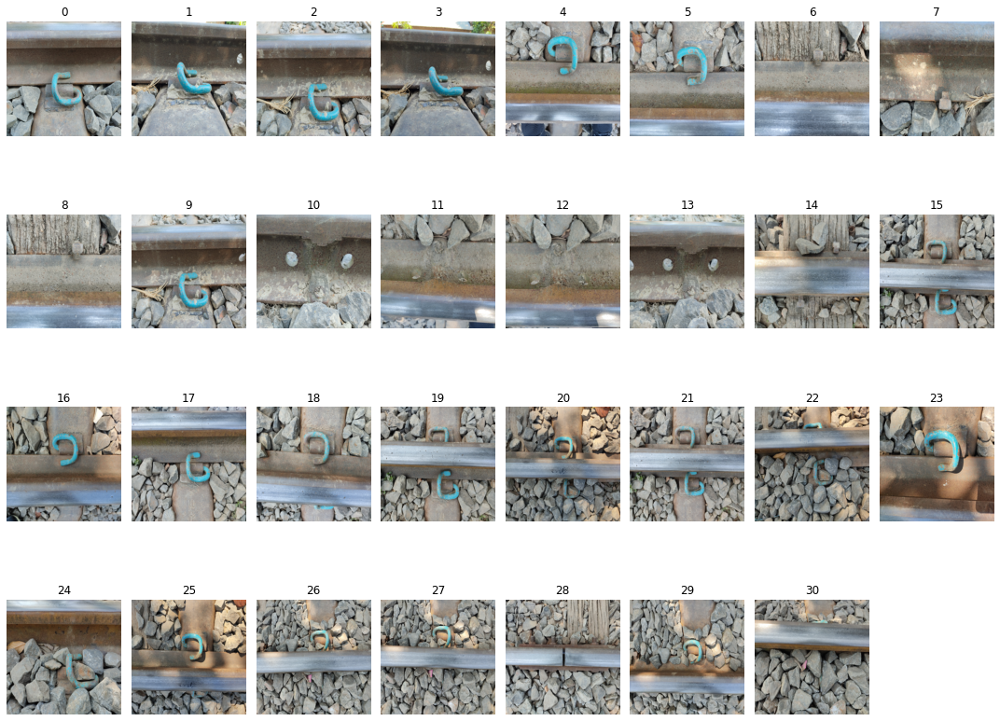

In [ ]:
draw_imgs(train_path,train_undef, 'Non defective')

# Defective Test Data

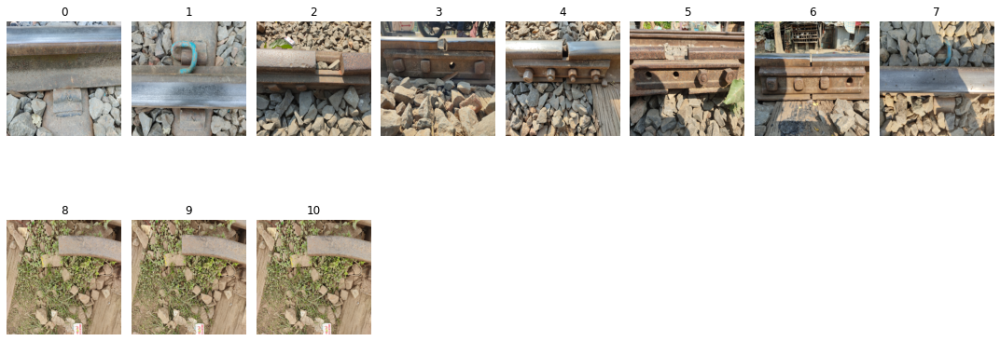

In [ ]:
draw_imgs(test_path, test_def, 'Defective')

# Undefective test data

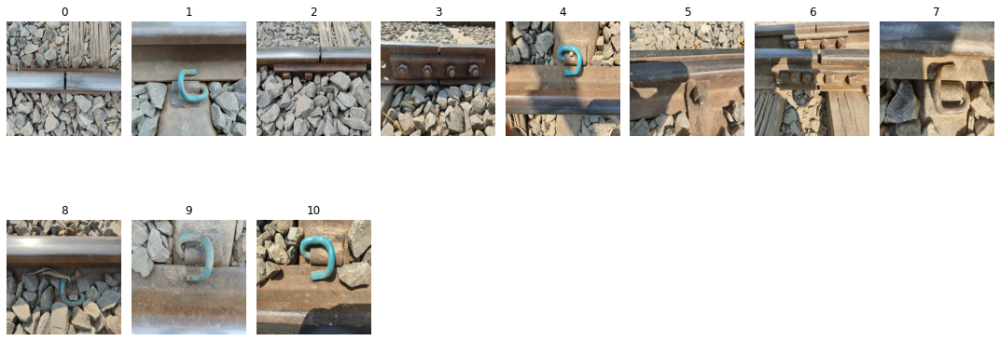

In [ ]:
draw_imgs(test_path, test_undef,'Non defective')

# Counts of defective and undefective

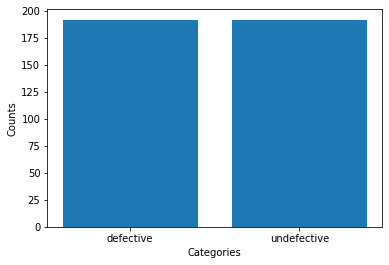

In [ ]:
y=[len(defective),len(undefective)]
x=['defective', 'undefective']
plt.xlabel('Categories')
plt.ylabel('Counts')
plt.bar(x, y)
plt.show()

# Image Resolutions

In [ ]:
widths, heights = [], []
defective_path_images = []

for path in tqdm(defective[0]):
    try:
        width, height = Image.open(test_path+'/Defective/'+path).size
        widths.append(width)
        heights.append(height)
        defective_path_images.append(test_path+'/Defective/'+path)
    except:
        try:
            width, height = Image.open(train_path+'/Defective/'+path).size
            widths.append(width)
            heights.append(height)
            defective_path_images.append(train_path+'/Defective/'+path)
        except:
            try:
                width, height = Image.open(val_path+'/Defective/'+path).size
                widths.append(width)
                heights.append(height)
                defective_path_images.append(val_path+'/Defective/'+path)
            except:
                continue
    
df_def = pd.DataFrame()
df_def["width"] = widths
df_def["height"] = heights
df_def["path"] = defective_path_images
df_def["scope"] = df_def["width"] * df_def["height"]

100%|██████████| 192/192 [03:03<00:00,  1.04it/s]


In [ ]:
df_def.sort_values('width').head(84)

,width,height,path,dimension
145,156,322,drive/MyDrive/r/Train/Defective/images.jpeg,50232
119,168,299,drive/MyDrive/r/Train/Defective/download (5).jpeg,50232
132,194,148,drive/MyDrive/r/Train/Defective/download (4).jpeg,28712
130,200,187,drive/MyDrive/r/Train/Defective/images (2).jpeg,37400
140,220,165,drive/MyDrive/r/Train/Defective/download (3).jpeg,36300
...,...,...,...,...
150,4000,3000,drive/MyDrive/r/Test/Defective/IMG_20201114_10...,12000000
171,4000,3000,drive/MyDrive/r/Validation/Defective/IMG_20201...,12000000
169,4000,3000,drive/MyDrive/r/Validation/Defective/IMG_20201...,12000000
152,4000,3000,drive/MyDrive/r/Test/Defective/IMG_20201114_10...,12000000


In [ ]:
df_def.head(84).mean()

<ipython-input-24-adf0410c3825>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_def.head(84).mean()


width        3.373262e+03
height       2.531929e+03
dimension    9.698216e+06
dtype: float64

In [ ]:
widths, heights = [], []
undef_imgs_dir = []

for path in tqdm(undefective[0]):
    try:
        width, height = Image.open(test_path+'/Non defective/'+path).size
        widths.append(width)
        heights.append(height)
        undef_imgs_dir.append(test_path+'/Non defective/'+path)
    except:
        try:
            width, height = Image.open(train_path+'/Non defective/'+path).size
            widths.append(width)
            heights.append(height)
            undef_imgs_dir.append(train_path+'/Non defective/'+path)
        except:
            try:
                width, height = Image.open(val_path+'/Non defective/'+path).shape
                print(width)
                widths.append(width)
                heights.append(height)
                undef_imgs_dir.append(val_path+'/Non defective/'+path)
            except:
                continue
    
df_undef = pd.DataFrame()
df_undef["width"] = widths
df_undef["height"] = heights
df_undef["path"] = undef_imgs_dir
df_undef["scope"] = df_undef["width"] * df_undef["height"]

100%|██████████| 192/192 [02:22<00:00,  1.35it/s]


In [ ]:
df_undef.sort_values('width').tail(84)

,width,height,path,dimension
138,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
81,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
159,4000,3000,drive/MyDrive/r/Test/Non defective/IMG_2020111...,12000000
80,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
78,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
...,...,...,...,...
55,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
56,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
57,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000
79,4000,3000,drive/MyDrive/r/Train/Non defective/IMG_202011...,12000000


In [ ]:
df_undef.head(84).mean()

<ipython-input-27-c41021bbf714>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df_undef.head(84).mean()


width            4000.0
height           3000.0
dimension    12000000.0
dtype: float64

## Ram Issues

In [ ]:
gc.collect()

76682

## Analysis
A 448x448 input model will work quite fine for this approach yet their will be quite a significant amount of loss of information

# Color Analysis
We need to do some color analysis to get an ida about the augmentation technique needed for this problem

In [ ]:
def is_grey_scale(givenImage):
    w,h = givenImage.size
    for i in range(w):
        for j in range(h):
            r,g,b = givenImage.getpixel((i,j))
            if r != g != b: return False
    return True

In [ ]:
def grey_mean(df_def_undef):
  sampleFrac = 0.4
  isGreyList = []
  for imageName in df_def_undef["path"].sample(frac=sampleFrac):
      val = Image.open(imageName).convert('RGB')
      isGreyList.append(is_grey_scale(val))
  print(np.sum(isGreyList) / len(isGreyList))
  del isGreyList
  
grey_mean(df_undef)
grey_mean(df_def)


0.0
0.0


## Intensity Analysis

In [ ]:
def intensity_analysis(df_def_undef):
  def get_rgb_men(row):
      img = cv2.imread(row['path'])
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      return np.sum(img[:,:,0]), np.sum(img[:,:,1]), np.sum(img[:,:,2])
  tqdm.pandas()
  df_def_undef['R'], df_def_undef['G'], df_def_undef['B'] = zip(*df_def_undef.progress_apply(lambda row: get_rgb_men(row), axis=1) )

In [ ]:
intensity_analysis(df_undef)
gc.collect()
intensity_analysis(df_def)
gc.collect()

100%|██████████| 192/192 [01:48<00:00,  1.76it/s]


0

In [ ]:
def show_color_dist(df, count):
    fig, axr = plt.subplots(count,2,figsize=(15,15))
    if df.empty:
        print("Image internsity of selected color is weak")
        return
    for idx, i in enumerate(np.random.choice(df['path'], count)):
        img = cv2.imread(i)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axr[idx,0].imshow(img)
        axr[idx,0].axis('off')
        axr[idx,1].set_title('R={:.0f}, G={:.0f}, B={:.0f} '.format(np.mean(img[:,:,0]), np.mean(img[:,:,1]), np.mean(img[:,:,2]))) 
        x, y = np.histogram(img[:,:,0], bins=255)
        axr[idx,1].bar(y[:-1], x, label='R', alpha=0.8, color='red')
        x, y = np.histogram(img[:,:,1], bins=255)
        axr[idx,1].bar(y[:-1], x, label='G', alpha=0.8, color='green')
        x, y = np.histogram(img[:,:,2], bins=255)
        axr[idx,1].bar(y[:-1], x, label='B', alpha=0.8, color='blue')
        axr[idx,1].legend()
        axr[idx,1].axis('off')

#### Red

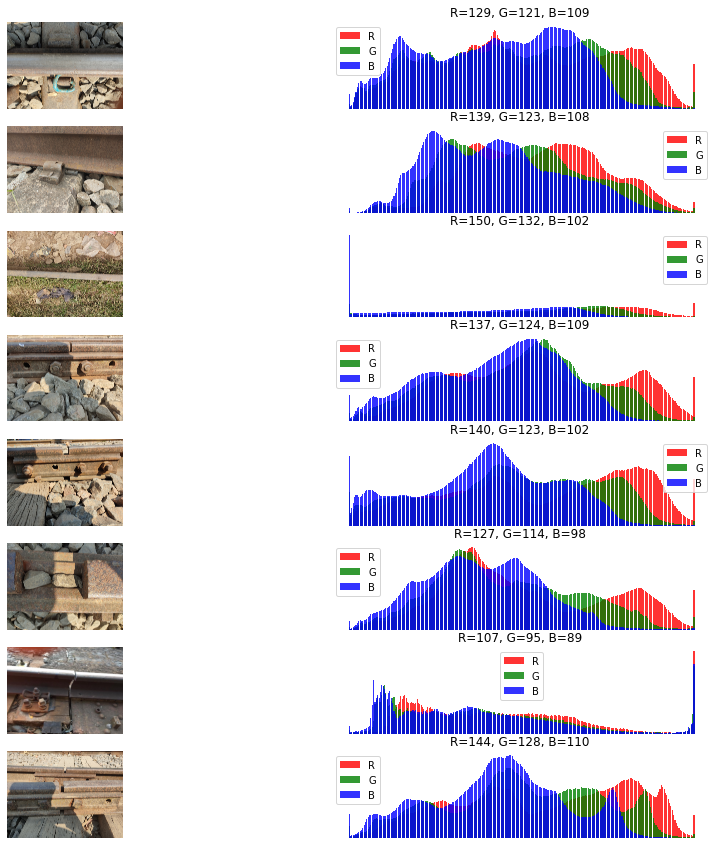

In [ ]:
df = df_def[((df_def['B']*1.05) < df_def['R']) & ((df_def['G']*1.05) < df_def['R'])]
show_color_dist(df, 8)

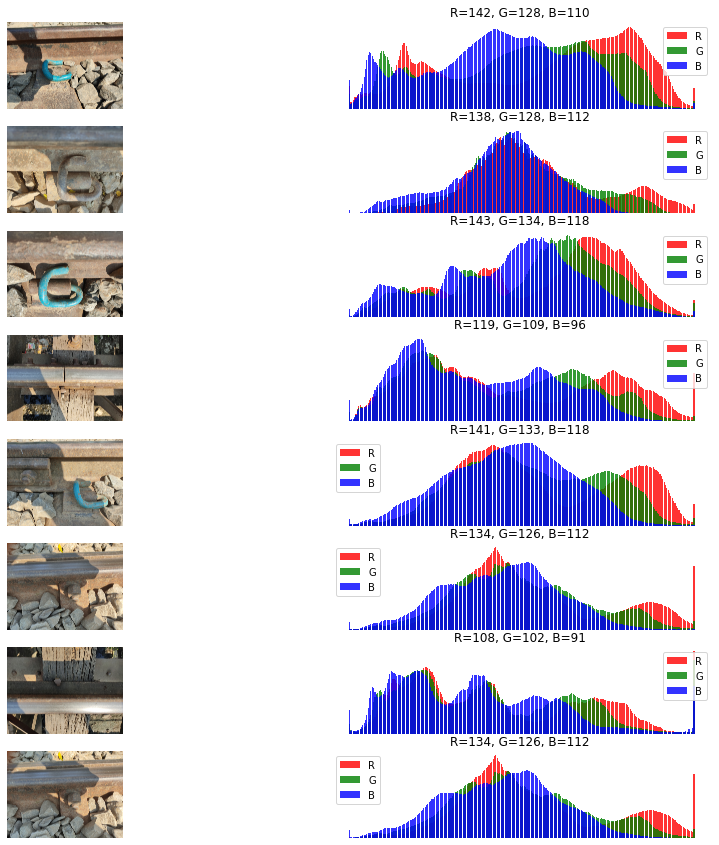

In [ ]:
df = df_undef[((df_undef['B']*1.05) < df_undef['R']) & ((df_undef['G']*1.05) < df_undef['R'])]
show_color_dist(df, 8)

#### Green

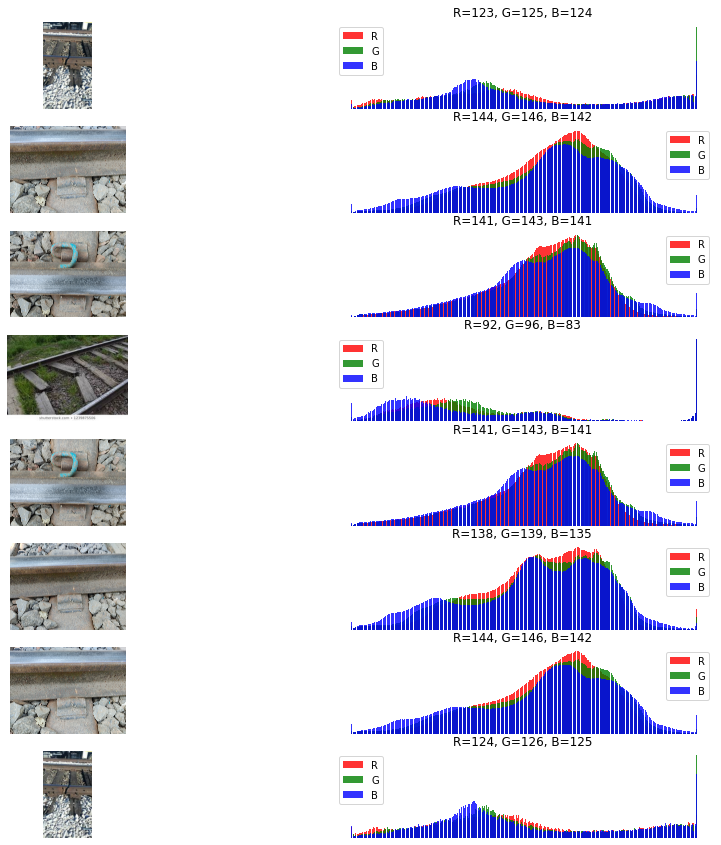

In [ ]:
df = df_def[(df_def['G'] > df_def['R']) & (df_def['G'] > df_def['B'])]
show_color_dist(df, 8)

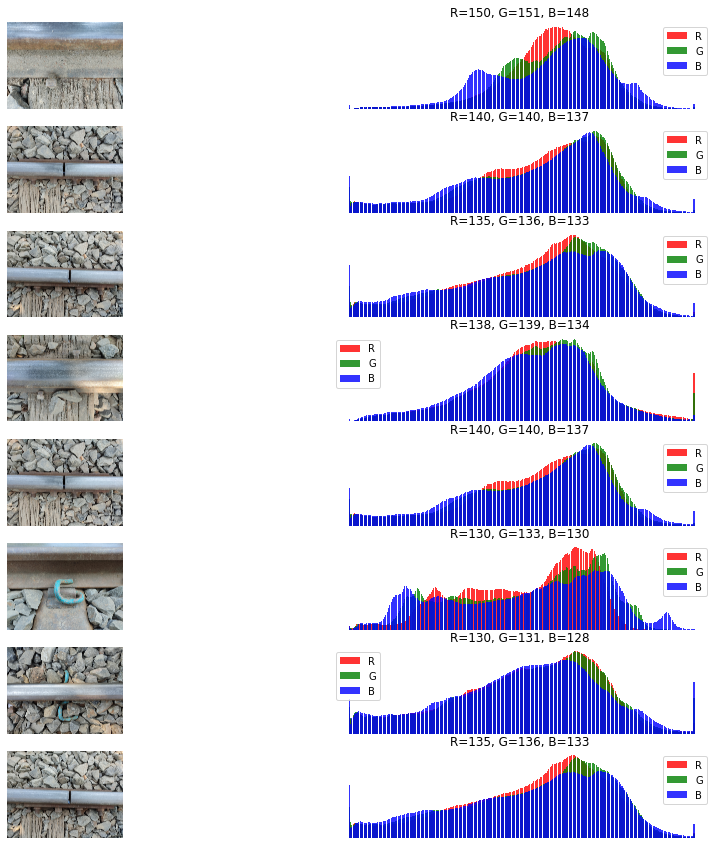

In [ ]:
df = df_undef[(df_undef['G'] > df_undef['R']) & (df_undef['G'] > df_undef['B'])]
show_color_dist(df, 8)

#### Blue

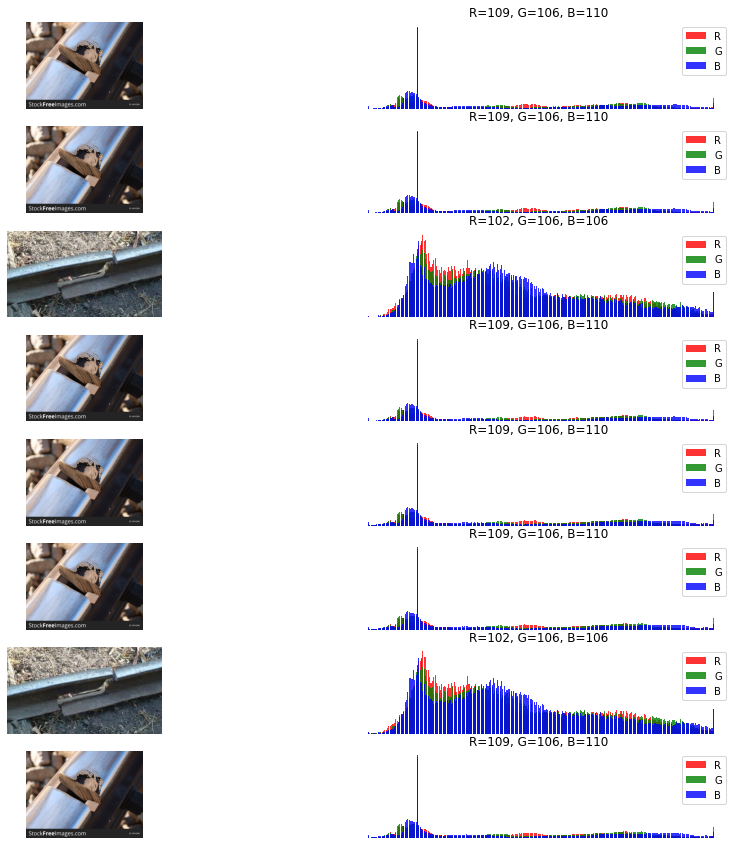

In [ ]:
df = df_def[(df_def['B'] > df_def['R']) & (df_def['B'] > df_def['G'])]
show_color_dist(df, 8)

In [ ]:
gc.collect()

447939

### Defective/Undefective

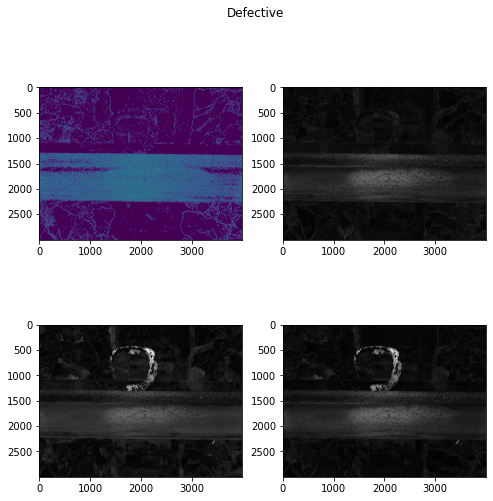

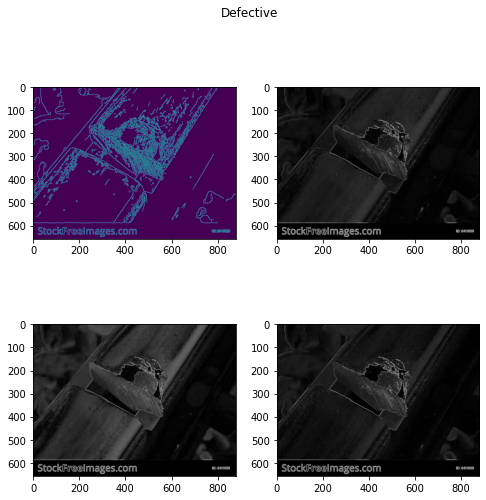

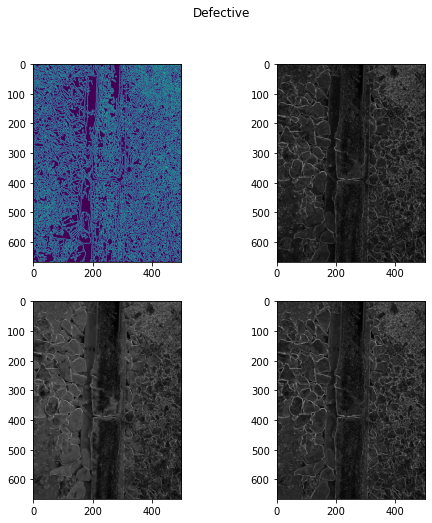

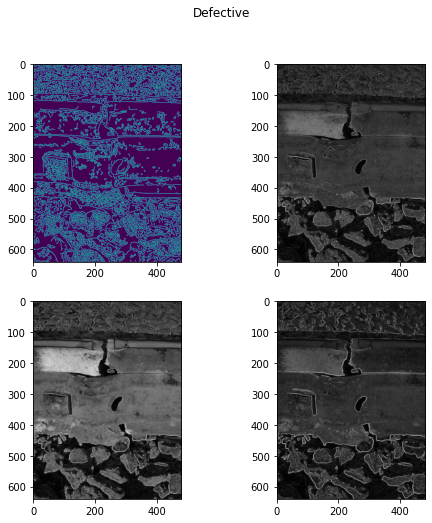

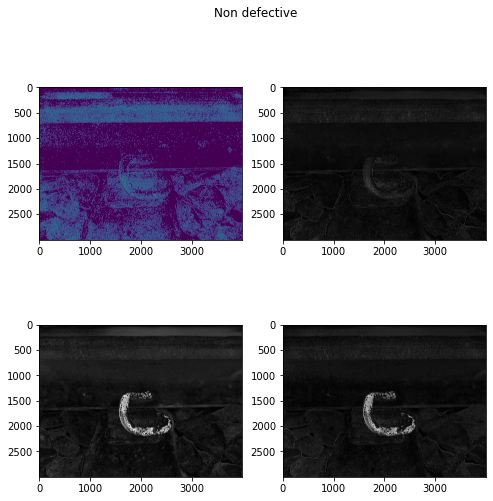

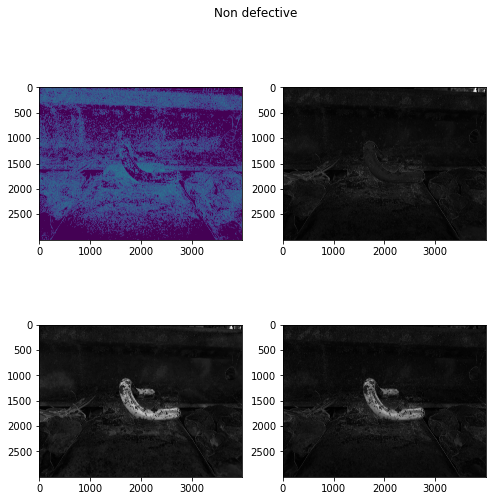

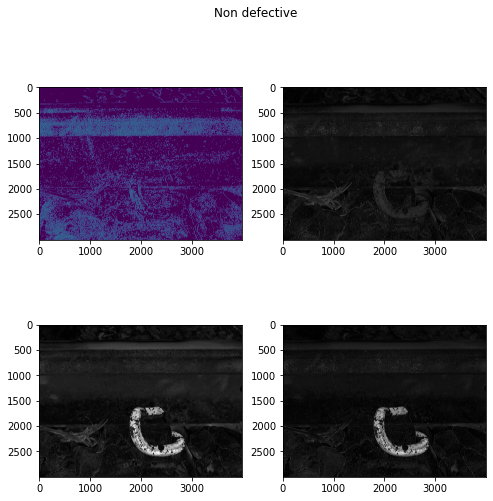

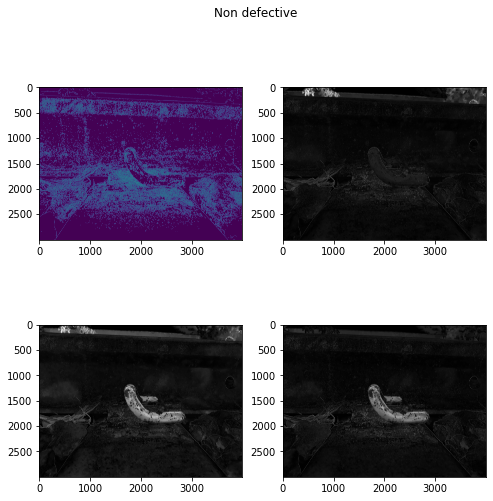

In [ ]:
def sobelcannyedges(df_def_undef, string):
  for path in df_def_undef['path'].head(4):
      image = cv2.imread(path)
      gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
      edges = sobel(image)
      gray_edges=canny(gray)
      scope = edges.shape
      fig = plt.figure(figsize=(8, 8))
      plt.suptitle(string)
      plt.subplot(2,2,1)
      plt.imshow(gray_edges)
      plt.subplot(2,2,2)
      plt.imshow(edges[:scope[0],:scope[1],0], cmap="gray")
      plt.subplot(2,2,3)
      plt.imshow(edges[:scope[0],:scope[1],1], cmap='gray')
      plt.subplot(2,2,4)
      plt.imshow(edges[:scope[0],:scope[1],2], cmap='gray')
  plt.show()
  
sobelcannyedges(df_def, 'Defective')
gc.collect()
print('\n\n')
sobelcannyedges(df_undef, 'Non defective')


### Defective

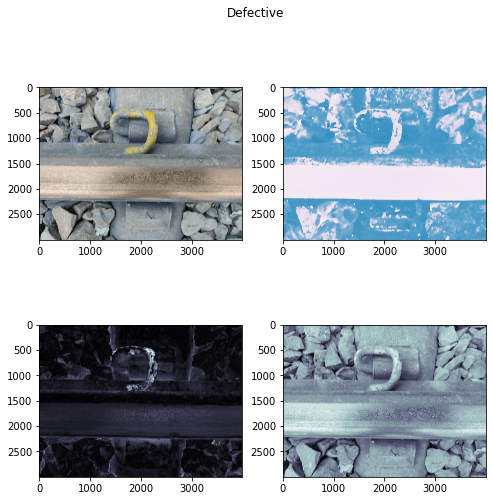

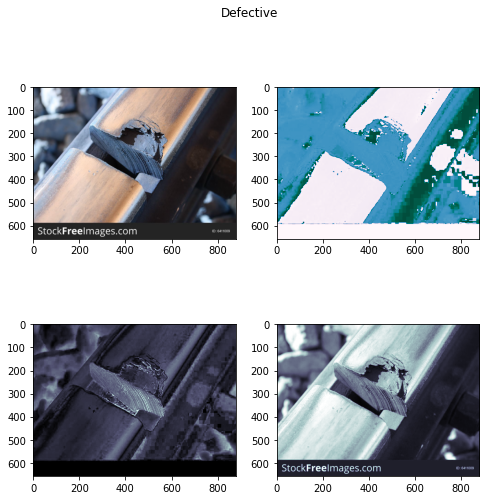

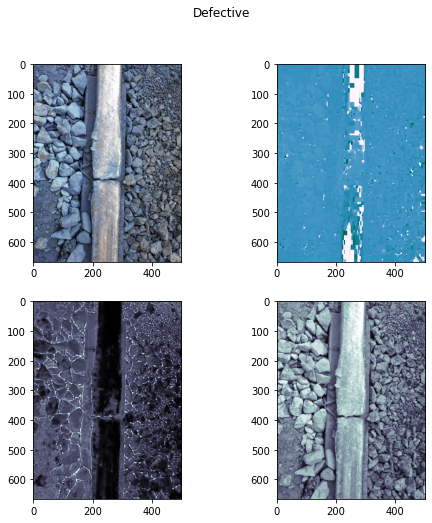

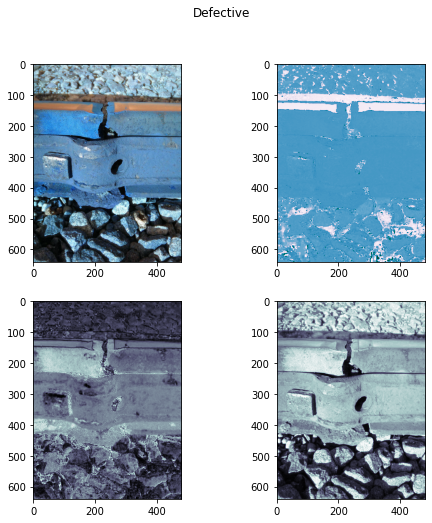

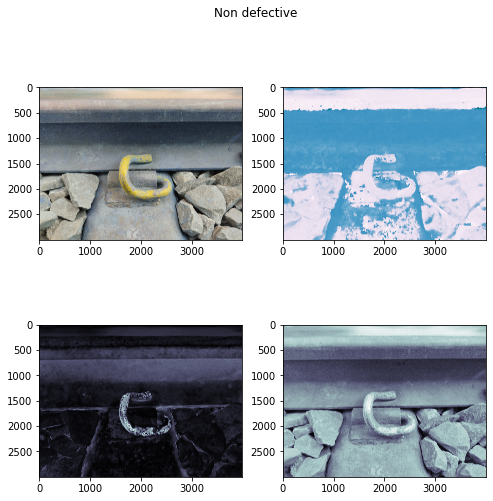

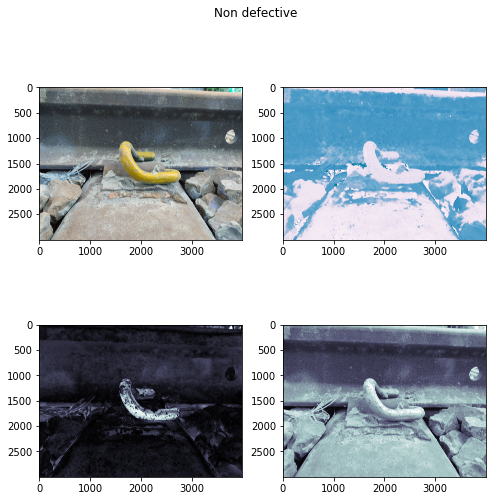

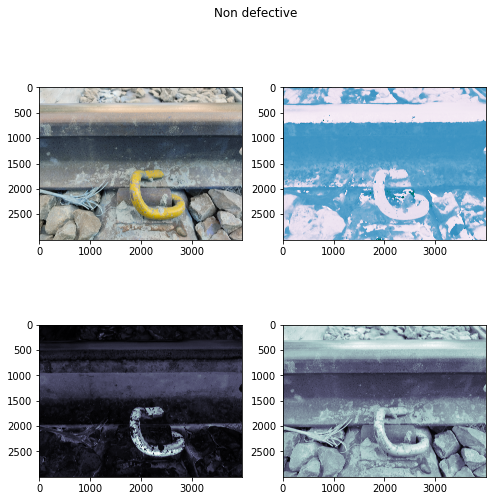

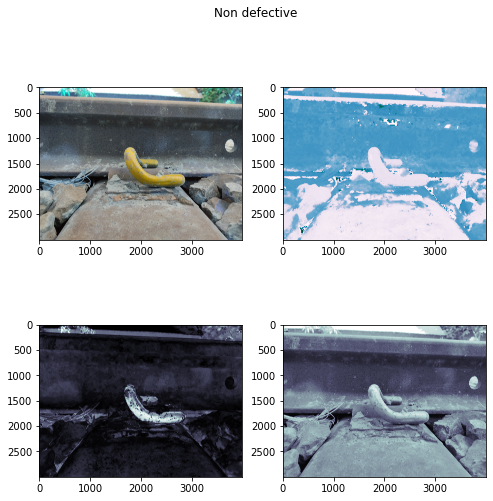

33785

In [ ]:
def rgb2hsv(df_def_undef, string):
  for path in df_def_undef['path'].head(4):
      image = cv2.imread(path)
      hsv = color.rgb2hsv(image)
      scope = hsv.shape
      fig = plt.figure(figsize=(8, 8))
      plt.suptitle(string)
      plt.subplot(2,2,1)
      plt.imshow(image)
      plt.subplot(2,2,2)
      plt.imshow(hsv[:scope[0],:scope[1],0], cmap="PuBuGn")
      plt.subplot(2,2,3)
      plt.imshow(hsv[:scope[0],:scope[1],1], cmap='bone')
      plt.subplot(2,2,4)
      plt.imshow(hsv[:scope[0],:scope[1],2], cmap='bone')
  plt.show()

rgb2hsv(df_def, 'Defective')
print('\n\n')
rgb2hsv(df_undef, 'Non defective')
gc.collect()

Method converts RGB(Red, Green, Blue) images to the HSV(Hue, Saturation, Value) color space and visualizes the results. In deep learning, color information can be important for image classification tasks, and the HSV color space provides a more representable colors to machine than the RGB colors. This method can help us to identify explicit patterns or characteristics in the color information.

## Corners

In [ ]:
def corners_images_gray(main_df, class_name):
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        corners_gray = cv2.goodFeaturesToTrack(gray, maxCorners=50, qualityLevel=0.02, minDistance=20)
        corners_gray = np.float32(corners_gray)
        for item in corners_gray:
            x, y = item[0]
            cv2.circle(image, (int(x), int(y)), 6, (0, 255, 0), -1)
        fig = plt.figure(figsize=(32, 32))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(image, cmap="BuGn")
        plt.show()

### Defective

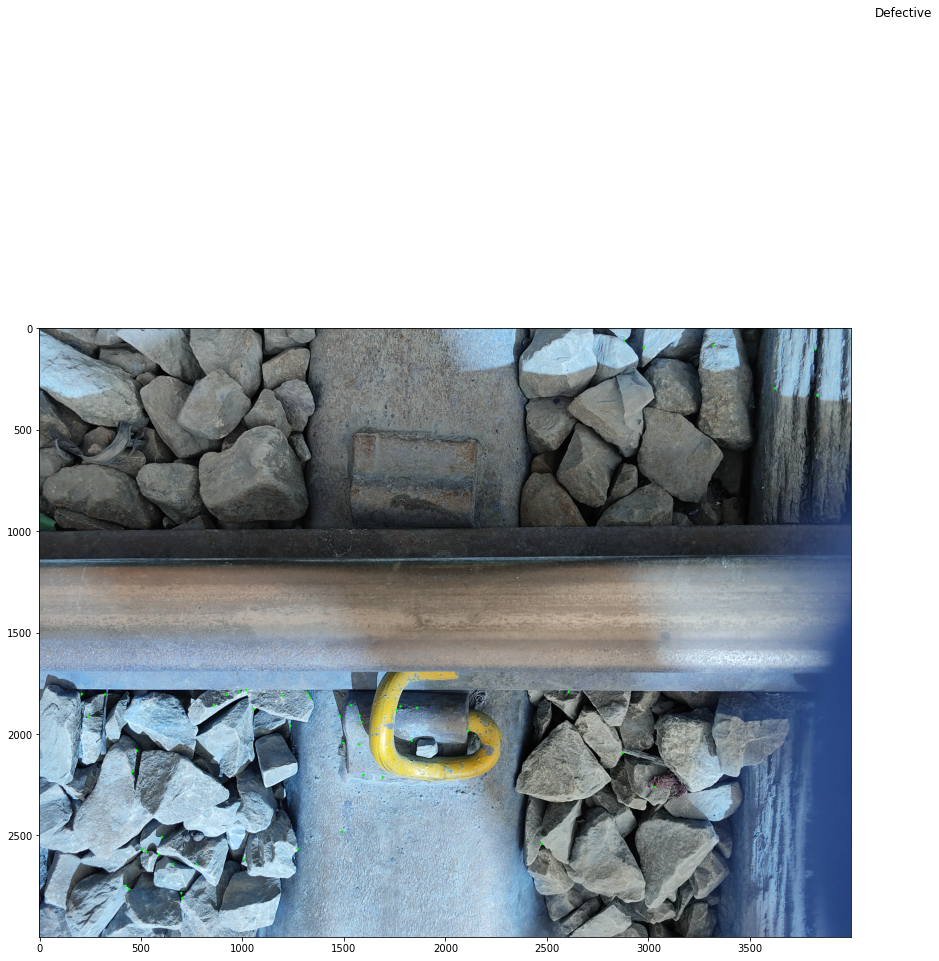

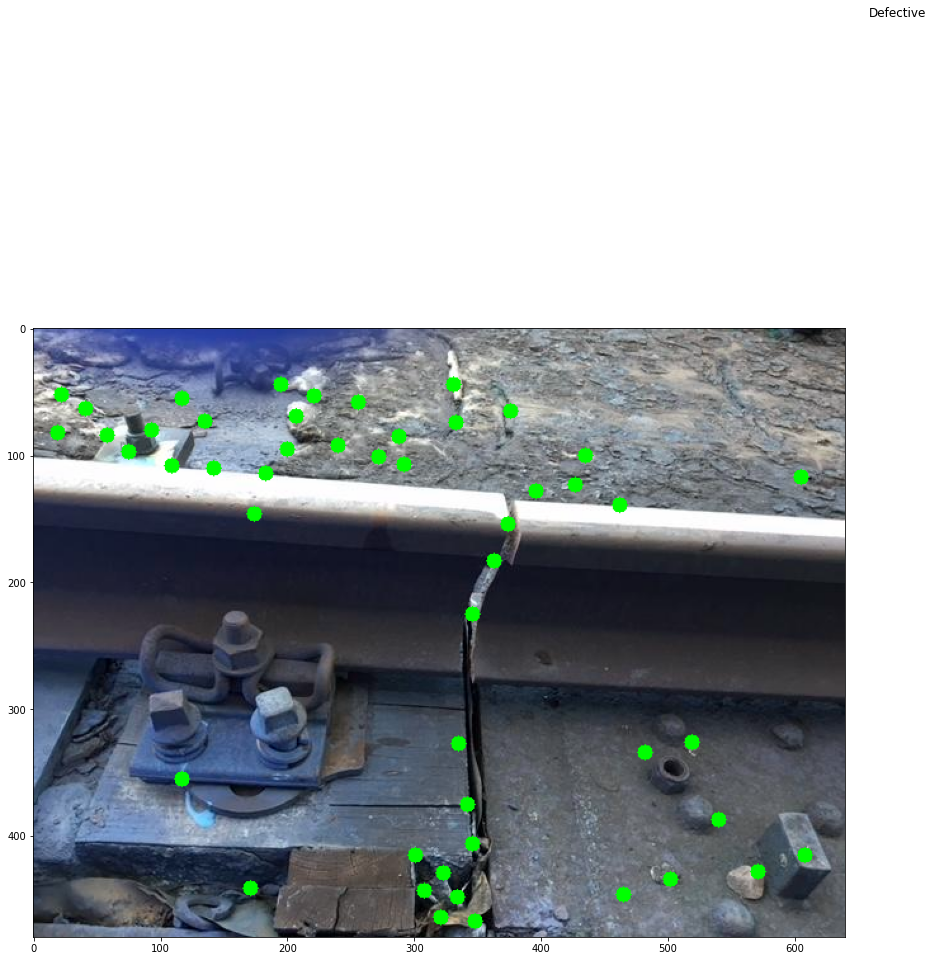

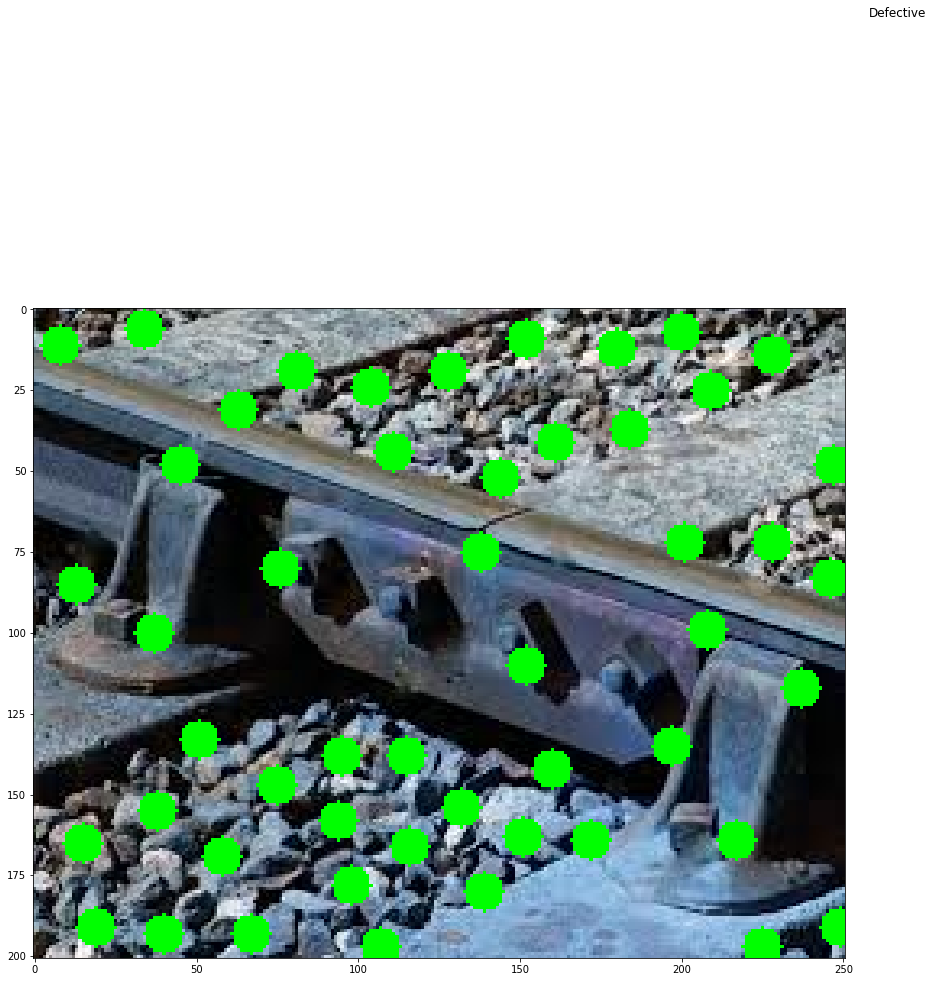

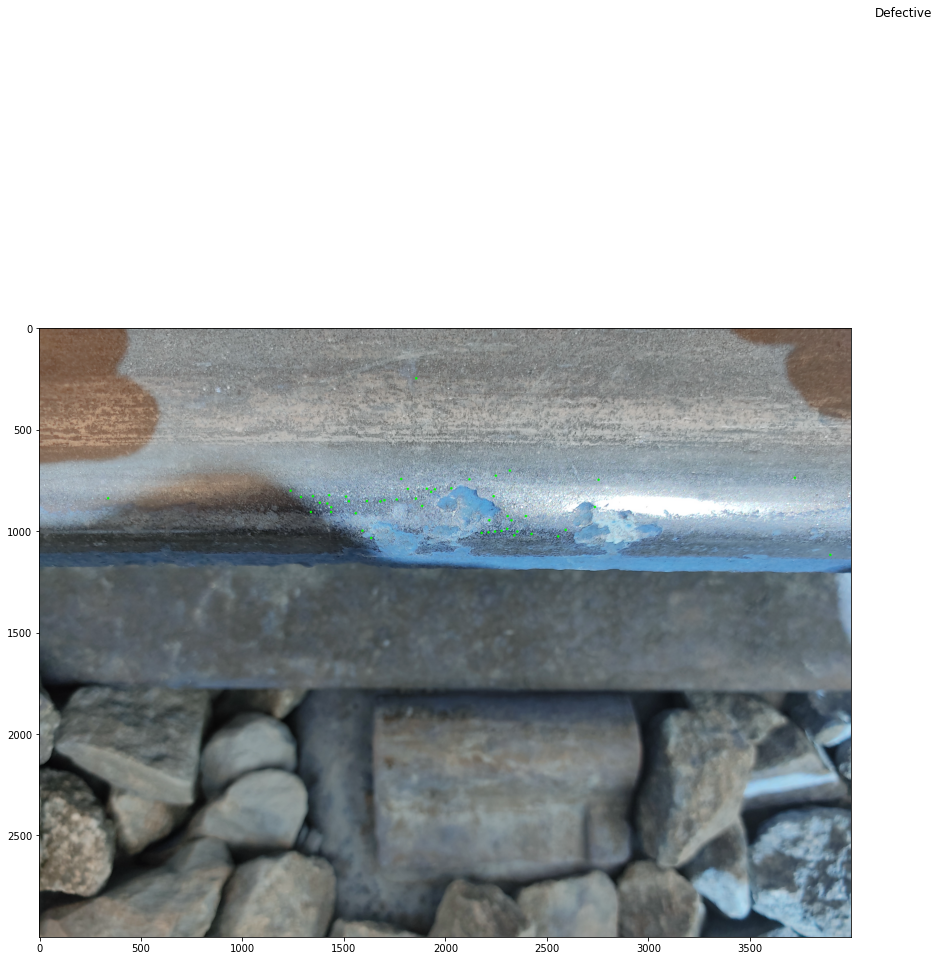

In [ ]:
corners_images_gray(df_def, "Defective")

### Undefective

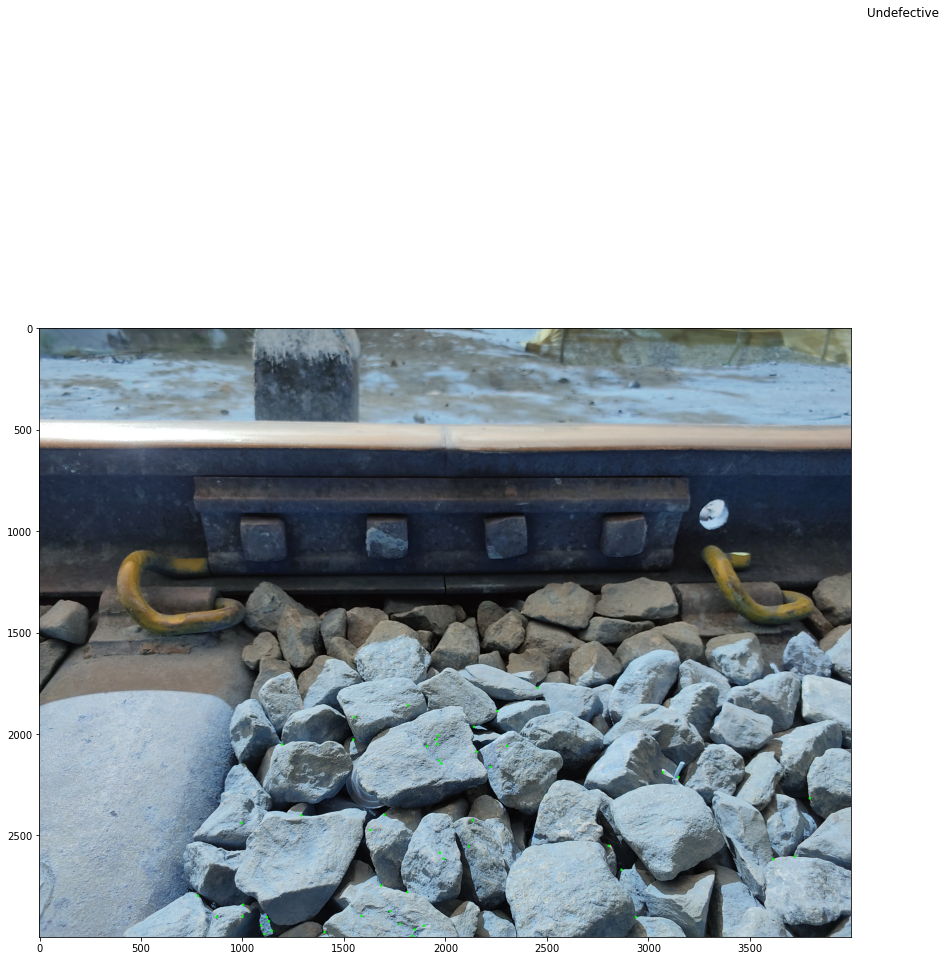

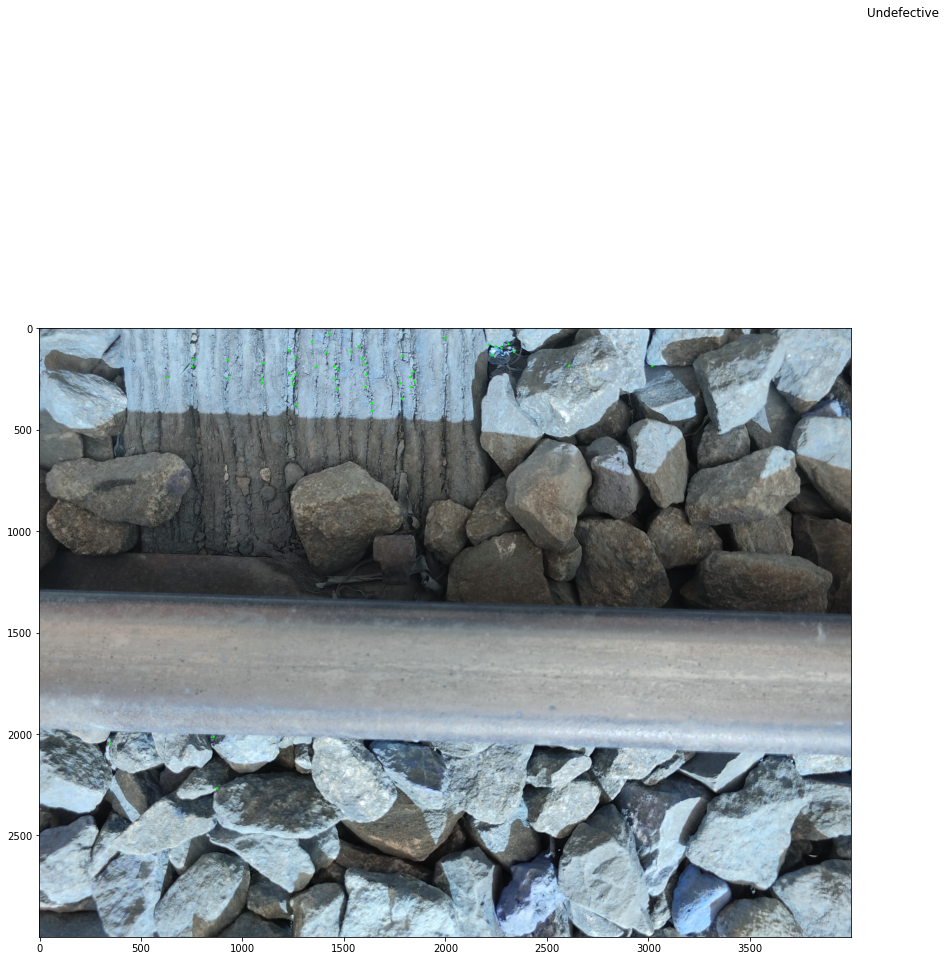

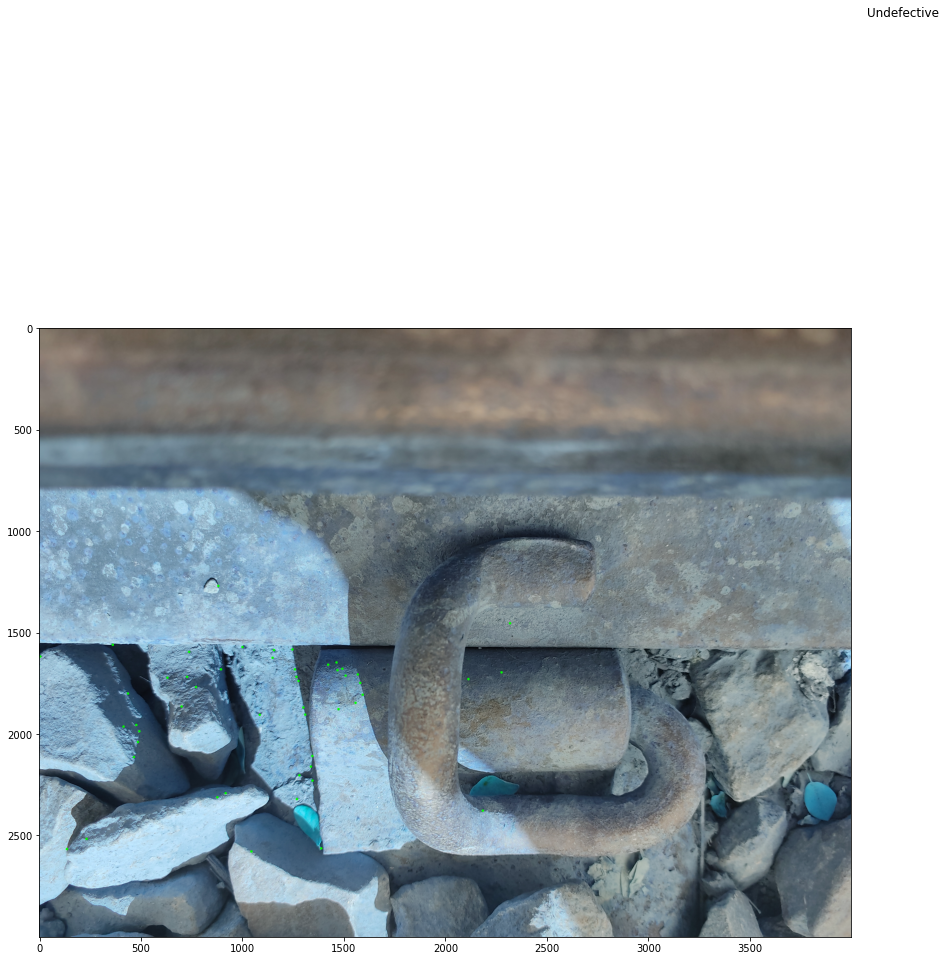

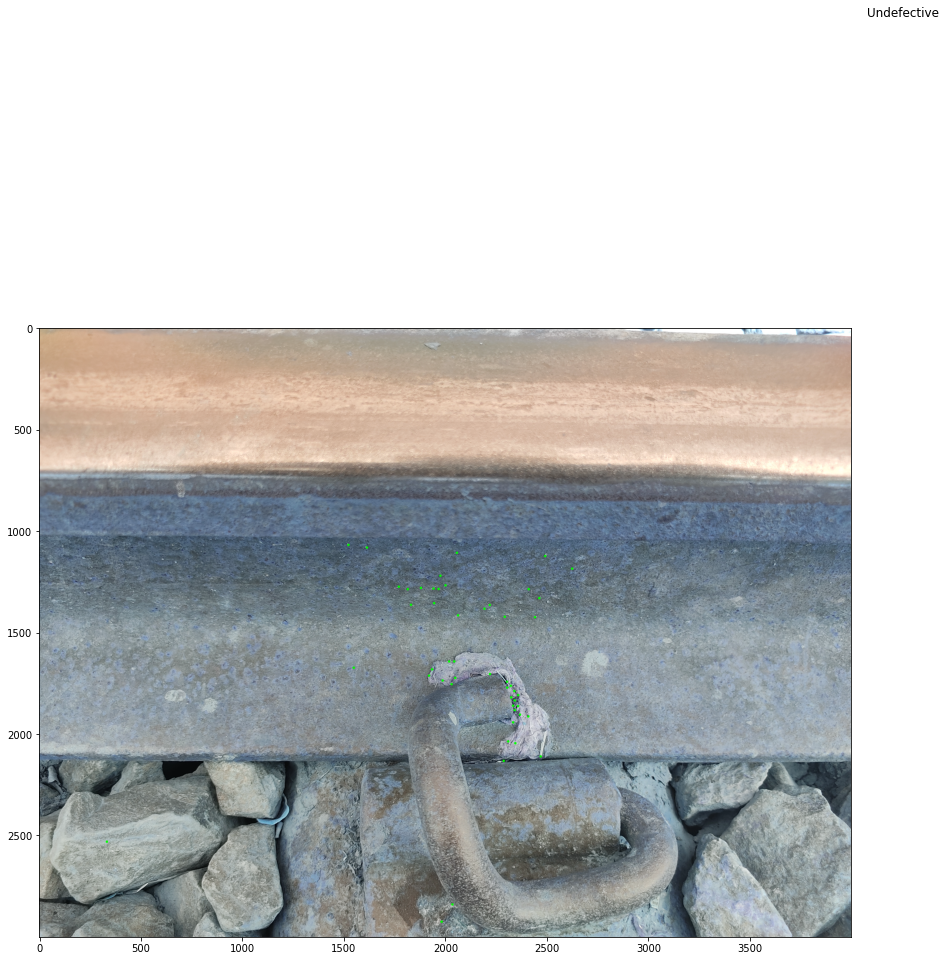

In [ ]:
corners_images_gray(df_undef, "Undefective")
gc.collect()

## Sift Features

In [ ]:
def sift_images_gray(main_df, class_name):
    for idx,i in enumerate(np.random.choice(main_df['path'],4)):
        image = cv2.imread(i)
        gray=cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        sift = cv2.SIFT_create()
        kp, des = sift.detectAndCompute(gray, None)
        kp_img = cv2.drawKeypoints(image, kp, None, color=(0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        fig = plt.figure(figsize=(32, 32))
        plt.suptitle(class_name)
        plt.subplot(2,2,1)
        plt.imshow(kp_img, cmap="viridis")
        plt.show()

### Defective

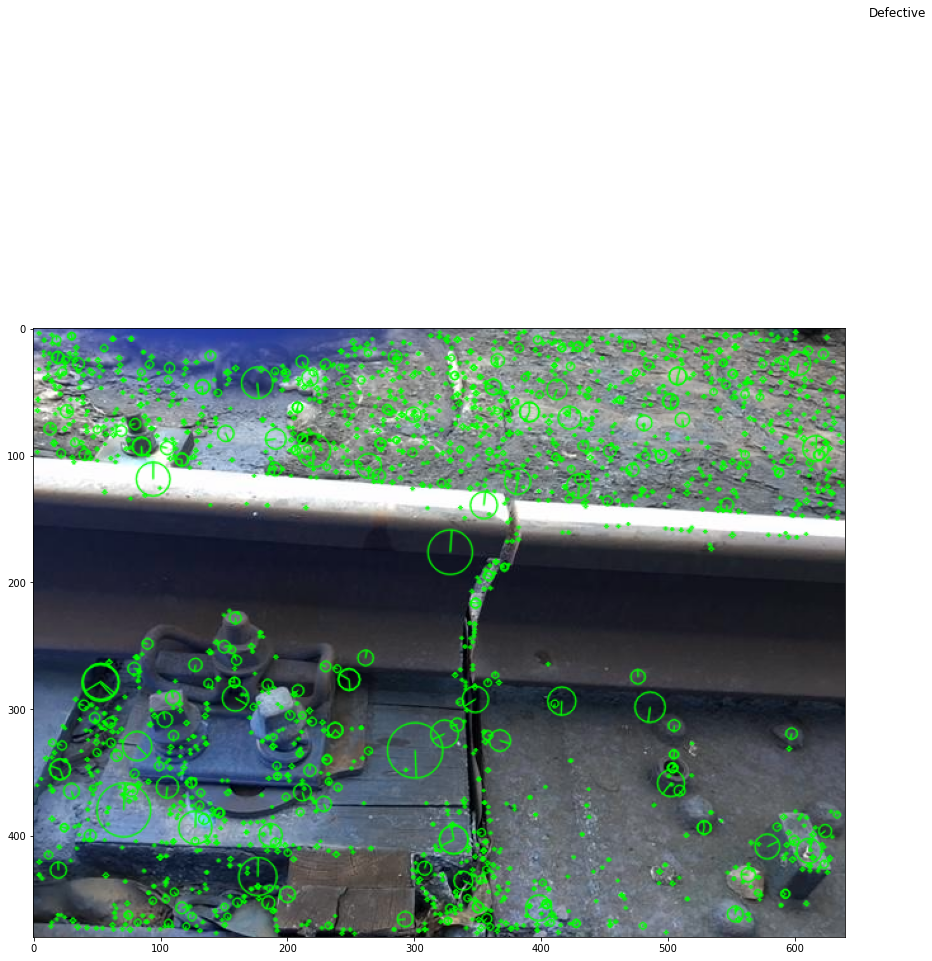

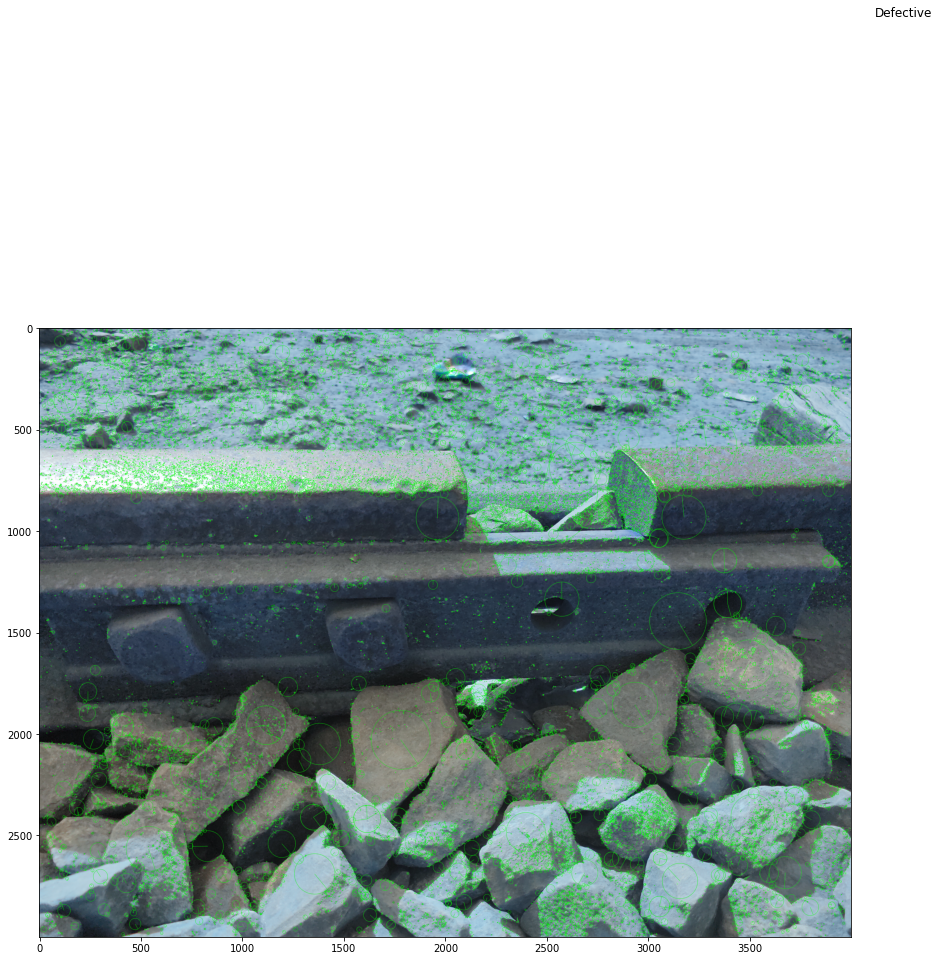

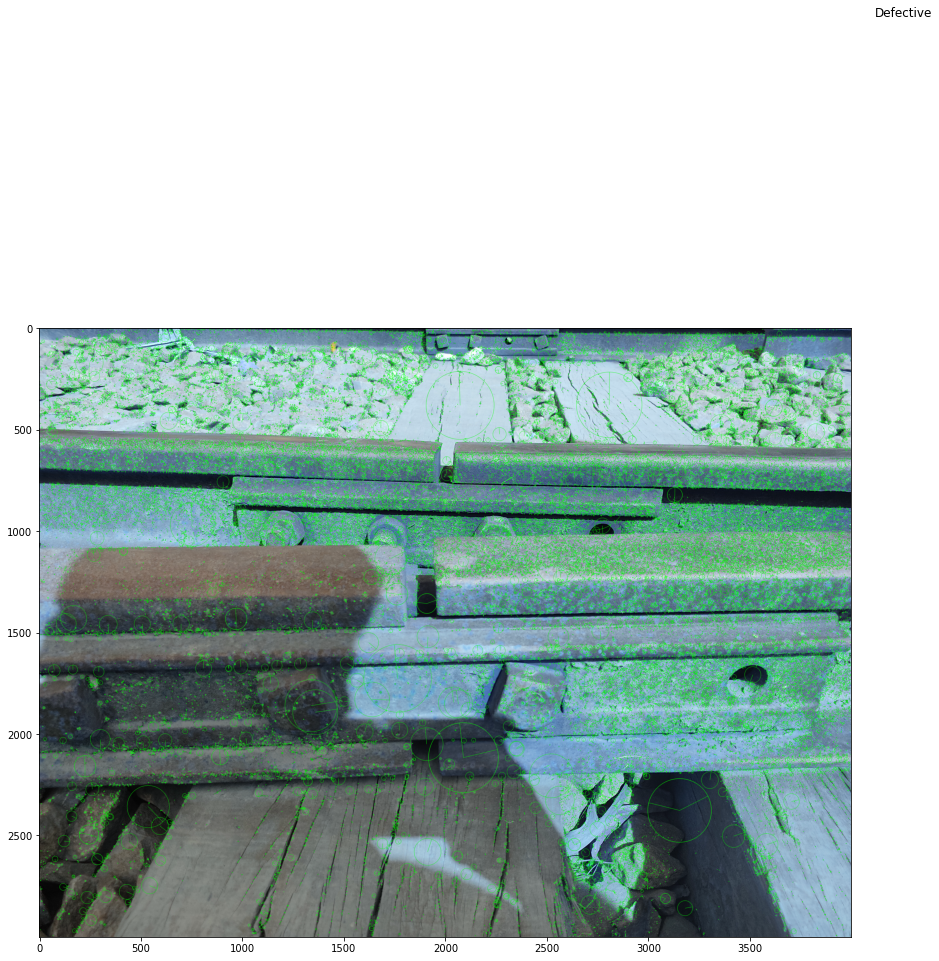

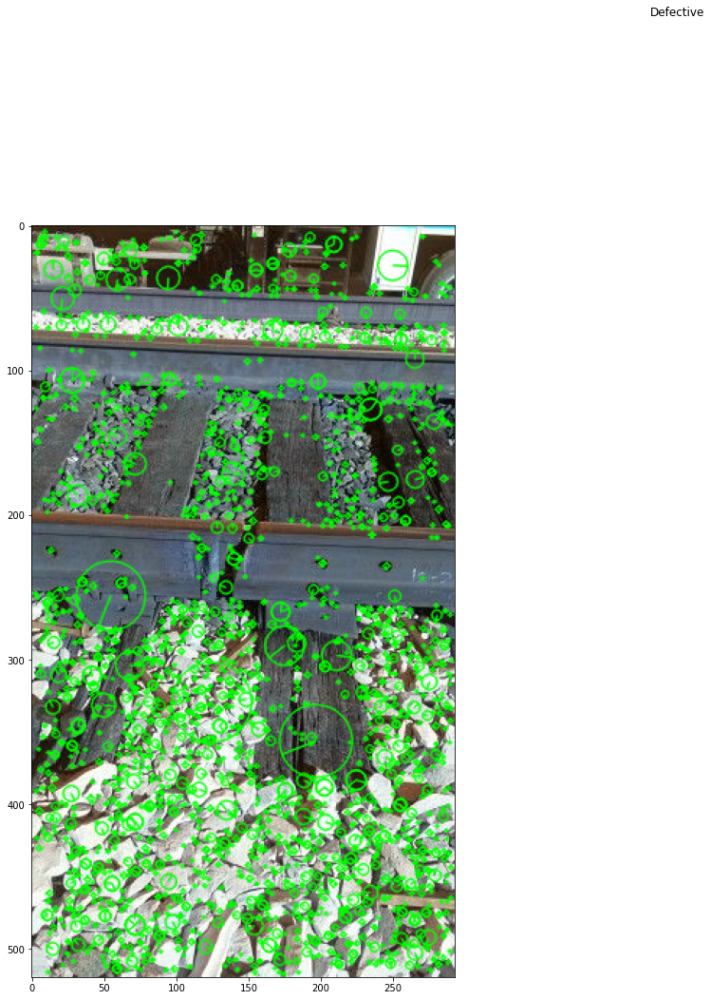

In [ ]:
sift_images_gray(df_def, "Defective")

### Undefective

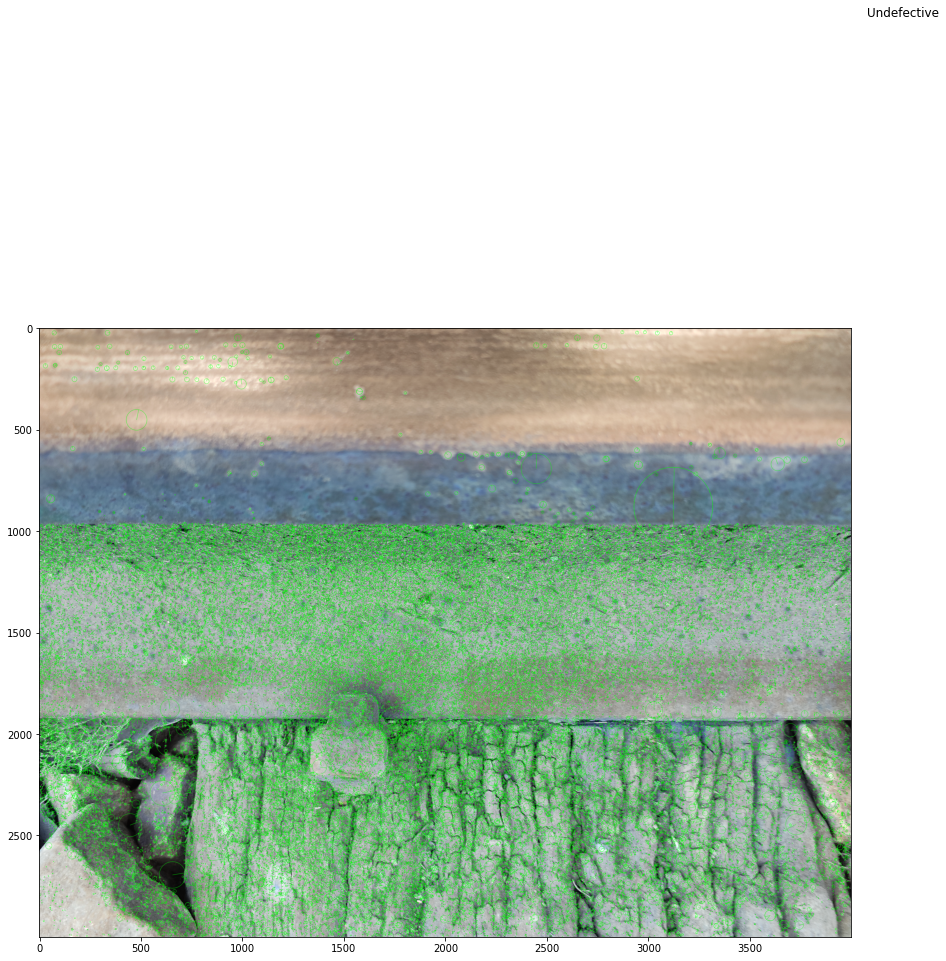

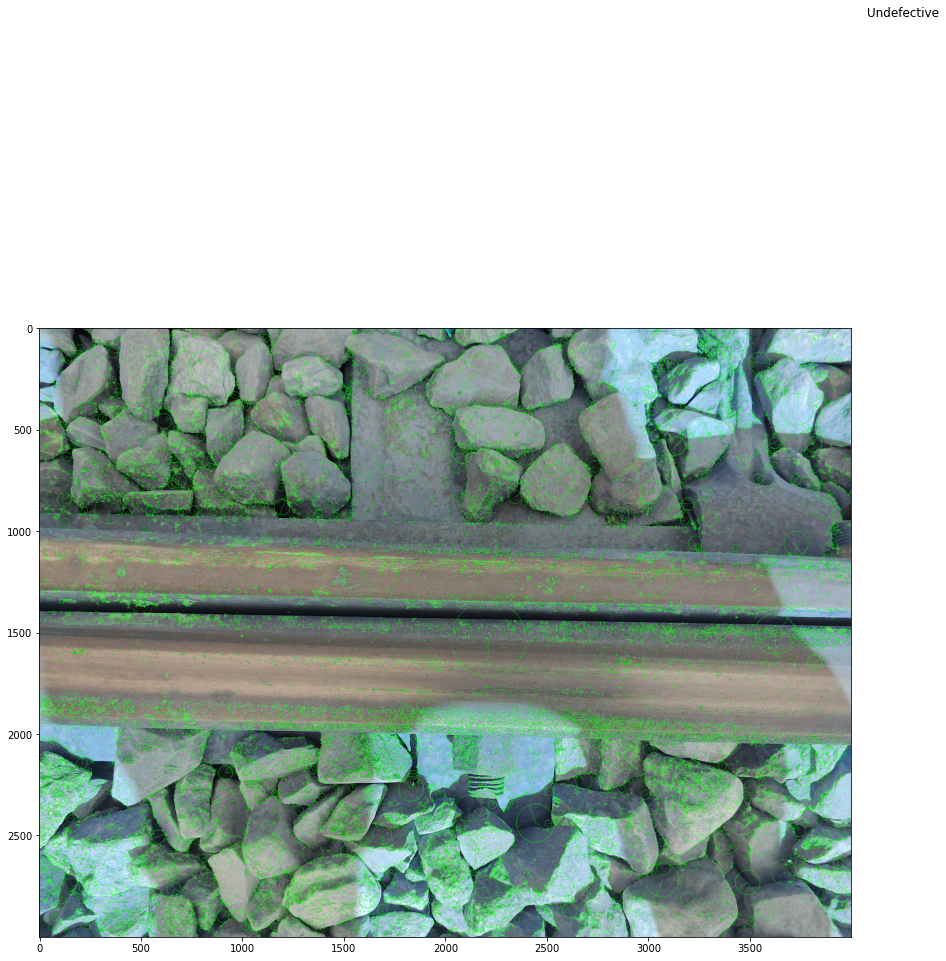

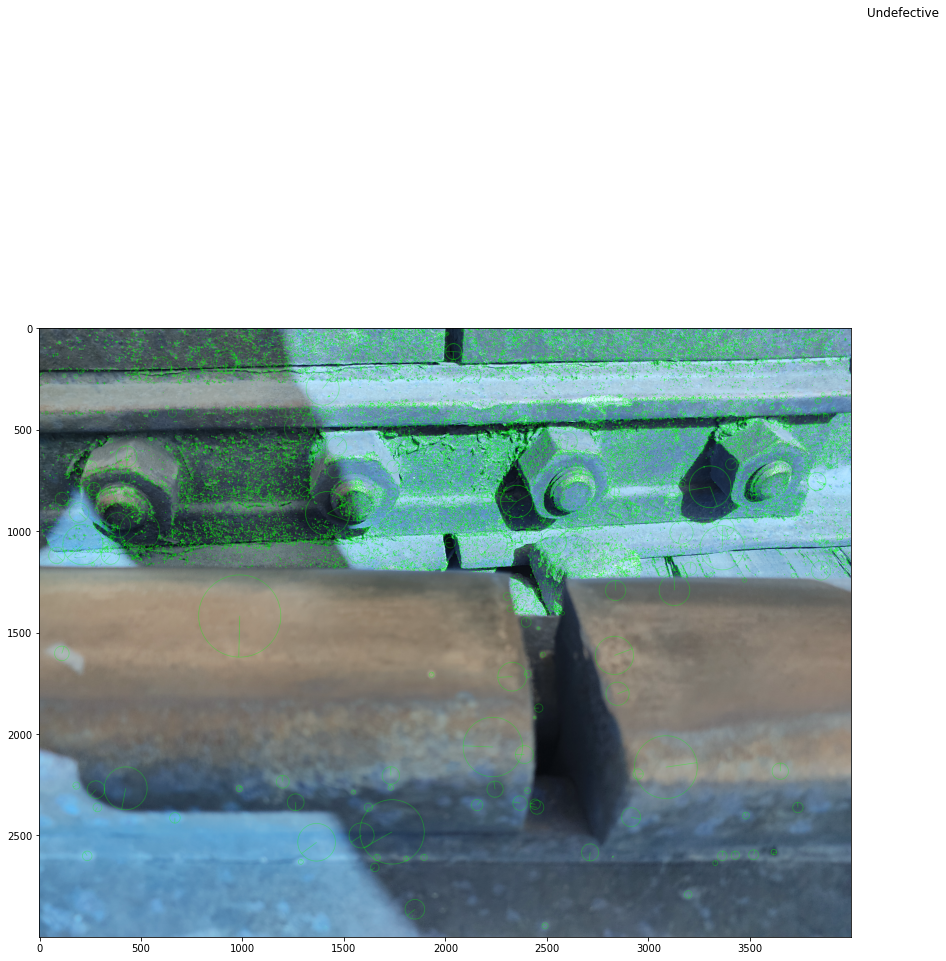

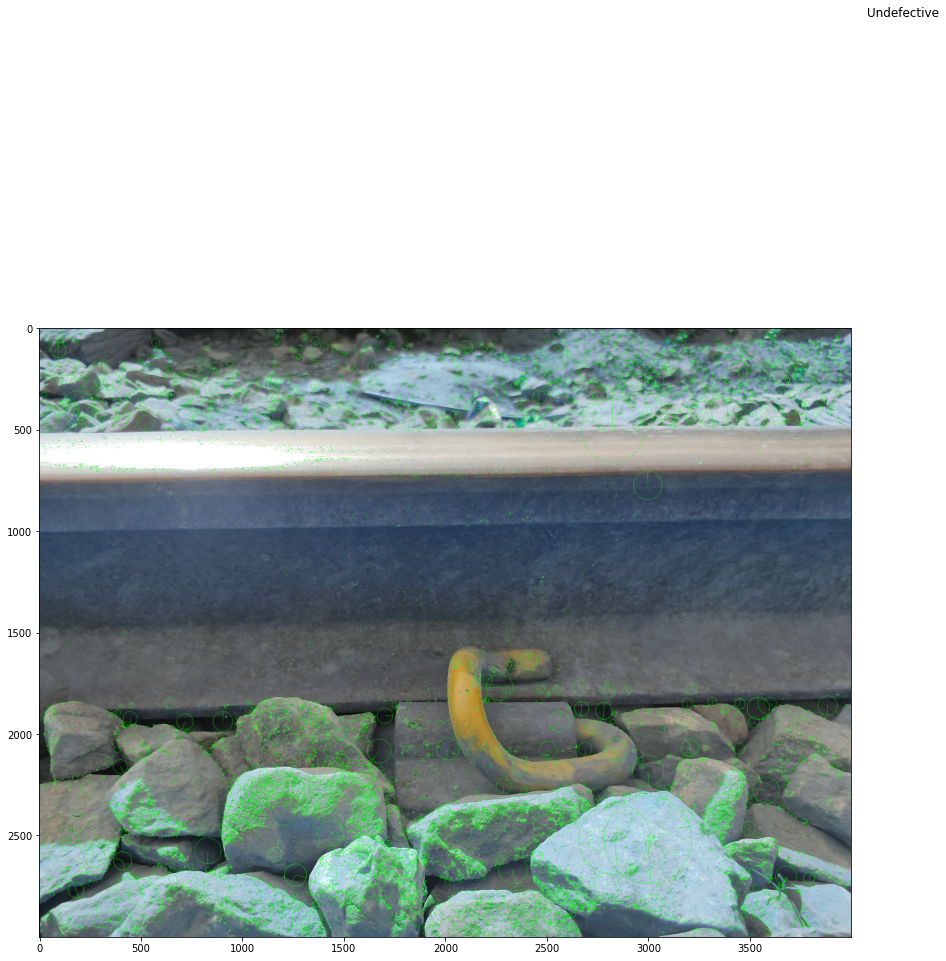

In [ ]:
sift_images_gray(df_undef, "Undefective")
gc.collect()

# Augmentations

In [ ]:
def plot_augimages(paths, datagen):
    plt.figure(figsize = (14,28))
    plt.suptitle('Augmented Images')
    
    midx = 0
    for path in paths:
        data = Image.open(path)
        data = data.resize((224,224))
        samples = expand_dims(data, 0)
        it = datagen.flow(samples, batch_size=1)
    
        # Show Original Image
        plt.subplot(10,5, midx+1)
        plt.imshow(data)
        plt.axis('off')
    
        # Show Augmented Images
        for idx, i in enumerate(range(4)):
            midx += 1
            plt.subplot(10,5, midx+1)
            
            batch = it.next()
            image = batch[0].astype('uint8')
            plt.imshow(image)
            plt.axis('off')
        midx += 1
    
    plt.tight_layout()
    plt.show()

## Data Generators

### Test Generators

In [ ]:
test_datagen = ImageDataGenerator()
test_generator = test_datagen.flow_from_directory(
    directory=test_path,
    target_size=(448, 448),
    color_mode="rgb",
    batch_size=32,
    class_mode="binary",
    shuffle=True,
    seed=42
)

Found 22 images belonging to 2 classes.


### Resnet50 Generators

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input

In [ ]:
r50_datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.10,
    brightness_range=[0.6,1.4],
    channel_shift_range=0.7,
    width_shift_range=0.15,
    height_shift_range=0.15,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode='nearest',
    preprocessing_function=preprocess_input
) 
r50_train = r50_datagen.flow_from_directory(
    directory=train_path,
    target_size=(448, 448),
    color_mode="rgb",
    batch_size=32,
    class_mode="binary",
    shuffle=True,
    seed=42,
    
)
r50_val = r50_datagen.flow_from_directory(
    directory=val_path,
    target_size=(448, 448),
    color_mode="rgb",
    batch_size=32,
    class_mode="binary",
    shuffle=True,
    seed=42,
)

Found 299 images belonging to 2 classes.
Found 62 images belonging to 2 classes.


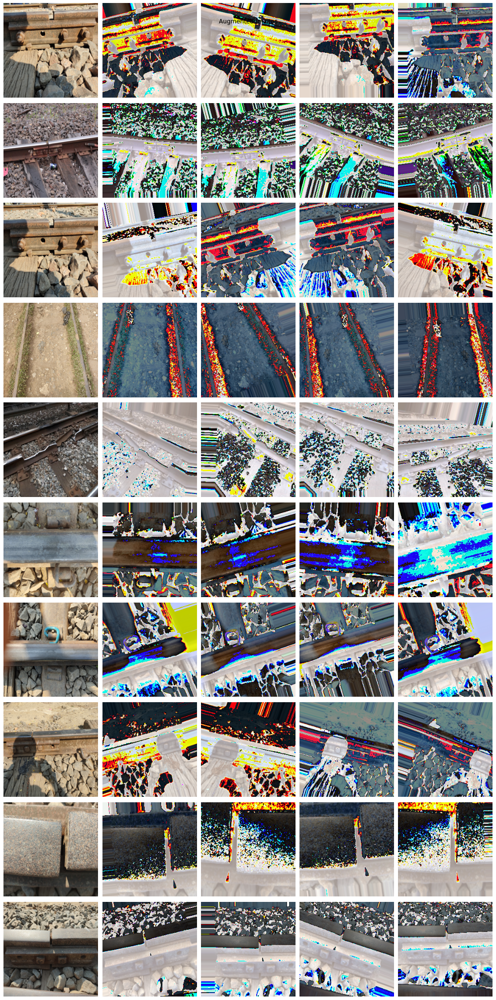

In [ ]:
plot_augimages(np.random.choice(df_def['path'],10), r50_datagen)

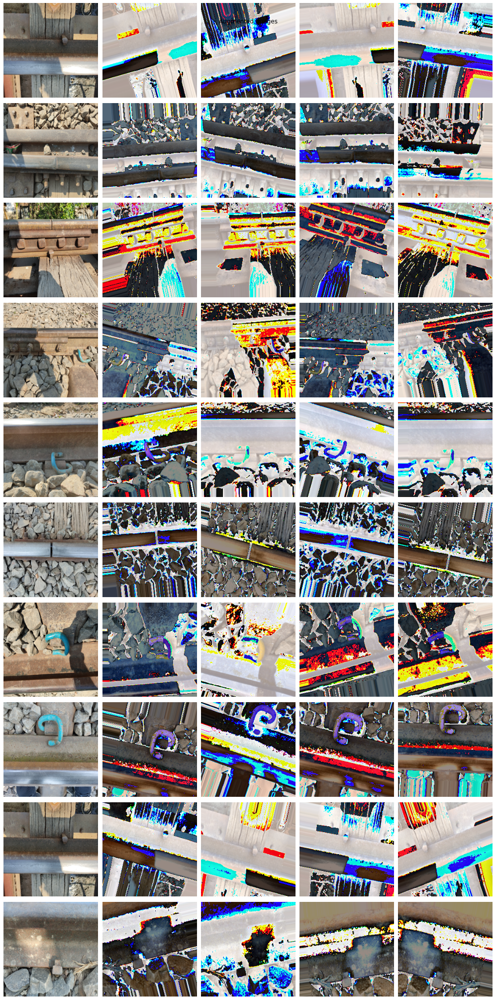

In [ ]:
plot_augimages(np.random.choice(df_undef['path'],10), r50_datagen)

## Methods and utils

In [ ]:
def gradcam_visualise(data, model, class_index):
    explainer = SmoothGrad()
    output = explainer.explain(data, model, class_index=class_index)
    return output

def activation_visualise(image, model, layers):
    explainer = ExtractActivations()
    output = explainer.explain([image], model, layers_name=layers)
    return output

In [ ]:
def plot_data_eight(class_name, outputs):
    fig = plt.figure(figsize=(32, 32))
    plt.suptitle(class_name)
    plt.subplot(4,2,1)
    plt.imshow(outputs[0])
    plt.subplot(4,2,2)
    plt.imshow(outputs[1])
    plt.subplot(4,2,3)
    plt.imshow(outputs[2])
    plt.subplot(4,2,4)
    plt.imshow(outputs[3])
    plt.subplot(4,2,5)
    plt.imshow(outputs[4])
    plt.subplot(4,2,6)
    plt.imshow(outputs[5])
    plt.subplot(4,2,7)
    plt.imshow(outputs[6])
    plt.subplot(4,2,8)
    plt.imshow(outputs[7])
    plt.show()

In [ ]:
def grad_cam(model, df_exp, class_name, pre_process_input, class_index):
    output_data = []
    for idx,i in enumerate(np.random.choice(df_exp[0],8)):
        image = cv2.imread(os.path.join(test_path, class_name)+'/'+i)
        image = cv2.resize(image, (448,448))
        image = pre_process_input(image)
        data = ([image], None)
        output = gradcam_visualise(data, model, class_index)
        output_data.append(output)
    plot_data_eight(class_name, output_data)

In [ ]:
def activations_model(model, df_exp, class_name, pre_process_input, layers):
    output_data = []
    for idx,i in enumerate(np.random.choice(df_exp[0],8)):
        image = cv2.imread(os.path.join(test_path, class_name)+'/'+i)
        image = cv2.resize(image, (448,448))
        image = pre_process_input(image)
        image = tf.expand_dims(image, axis=0)
        output = activation_visualise([image], model, layers)
        output_data.append(output)
    plot_data_eight(class_name, output_data)

##Resnet50 Model creation

In [ ]:
resnet50 = ResNet50(include_top = False, input_shape = (448,448,3), weights = 'imagenet')
# setting include_top to False to remove the fully connected layers at the end of the network
# setting input_shape to (448,448,3) to specify the size of the input images
# setting weights to 'imagenet' to initialize the model with pre-trained weights

for layer in resnet50.layers:
    layer.trainable = False

x = GlobalAveragePooling2D()(resnet50.output)
predictions = Dense(1, activation='sigmoid')(x)
#  GlobalAveragePooling2D layer to the output of the ResNet50 model, 
#  which reduces the spatial dimensions of the output feature map

model_resnet50 = Model(inputs = resnet50.input, outputs = predictions)
gc.collect()

94765736/94765736 [==============================] - 5s 0us/step


1171

ResNet50 is a powerful pre-trained CNN architecture that has been shown to perform well in image classification tasks(feature detecting and etc). By adding a final classification layer on top of the pre-trained ResNet50 model, we can fine-tune the model for our specific classification task

In [ ]:
model_resnet50.compile(loss='binary_crossentropy', optimizer="adam", metrics=['accuracy'])

In [ ]:
history_pretrained_model = model_resnet50.fit(
      r50_train,
      validation_data=r50_val,
      epochs=30,
      verbose=2)

Epoch 1/30


KeyboardInterrupt: ignored

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_pretrained_model.history['accuracy'])
plt.plot(history_pretrained_model.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history_pretrained_model.history['accuracy'])
plt.plot(history_pretrained_model.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.show()

# Model Save

In [ ]:
model_resnet50.save('./model_resnet50.h5')